In [1]:
import numpy as np 
import pickle
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd

In [2]:
file_name = r'../data/centroids_all_NOR_1x1.pkl'
with open(r"../data/centroids_all_NOR_1x1.pkl", "rb") as file:
    df_2020 = pickle.load(file)

df_2020

FileNotFoundError: [Errno 2] No such file or directory: '../data/centroids_all_NOR_1x1.pkl'

In [ ]:
# Ensure geometries are in lat/lon (WGS84)
df_2020 = df_2020.to_crs(epsg=4326)

# Get centroids of polygons
df_2020['centroid'] = df_2020.geometry.centroid

# Extract lat/lon from centroids
df_2020['lat'] = df_2020.centroid.y
df_2020['lon'] = df_2020.centroid.x

# Define bin size
bin_size = 0.08

# Create lat/lon bins
df_2020['lat_bin'] = (df_2020['lat'] / bin_size).round(0) * bin_size
df_2020['lon_bin'] = (df_2020['lon'] / bin_size).round(0) * bin_size

# Sample one centroid per bin
sampled = df_2020.groupby(['lat_bin', 'lon_bin']).sample(n=1, random_state=42).reset_index(drop=True)

print(f"Sampled: {len(sampled)} polygons")


In [ ]:
sampled

### Plotting Samples Distribution

In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

def plotting_samples_norway(df):    
    # Load the shapefile of Norway's boundaries (assuming you have this shapefile)
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Step 2: Plot the map
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Assuming 'result' DataFrame has columns 'longitude' and 'latitude' (from the grid centroids)
    result_geo_df = gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
    
    # Plot the filtered points inside Norway
    result_geo_df.plot(ax=ax, markersize=3, color='red', alpha=0.5, label="Assemblages")
    
    # Customize plot
    ax.set_title("Randomly Sampled Grids 2018", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    
    # Show the plot
    plt.show()

In [ ]:
plotting_samples_norway(sampled)

### Generating Climatic Maps

In [7]:
import netCDF4  # or import h5netcdf
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [8]:
def read_netcdf_stack(file_paths, latitude, longitude, grid):
    patches = []
    # scaler = MinMaxScaler(feature_range=(0, 1))  # Define the scaler

    for file_path in file_paths:
        data = xr.open_dataset(file_path)
        variable = list(data.data_vars.keys())[-1]

        lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
        lon_idx = np.argmin(np.abs(data['lon'].values - longitude))

        patch = data[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        ).fillna(0).values  # Convert to NumPy

        print(f"Shape of patch for {file_path} {variable}: {patch.shape}")

        # Remove extra dimension if necessary
        if patch.shape[0] == 1:
            patch = patch[0]

        # # Reshape for MinMax scaling (flatten to 2D)
        # patch_reshaped = patch.reshape(-1, 1)  # Flatten but keep 1 feature

        # # Apply MinMax Scaling
        # patch_scaled = scaler.fit_transform(patch_reshaped)

        # # Reshape back to original (grid*2, grid*2)
        # patch_scaled = patch_scaled.reshape(patch.shape)

        # patches.append(patch_scaled)  # Add scaled patch
        
        patches.append(patch)  # Add NOT scaled patch


    # Stack along last axis (channels dimension)
    stacked_patches = np.stack(patches, axis=-1)

    return stacked_patches

In [16]:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables =['gdd5','bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd']

stacked_patches_list = []
# x = 100
for i in range(sampled.shape[0]): # gbif_assemblages.shape[0]
    sample =  sampled.iloc[i]
    file_paths = [f"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/{var}/CHELSA_EUR11_obs_{var}_2019_V.2.1.nc" for var in variables]
    file_paths.append(path_altitude)
    
    # Call the function to get the stacked patches
    stacked_patches = read_netcdf_stack(file_paths = file_paths, 
                                        latitude = sample.latitude, 
                                        longitude = sample.longitude, 
                                        grid = 16) # better to use multiples of 64
    
    stacked_patches_list.append(stacked_patches)

    print(f'Sample {i} correctly stacked and added to the list')
    print('\n\n')

Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/gdd5/CHELSA_EUR11_obs_gdd5_2019_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio12d/CHELSA_EUR11_obs_bio12d_2019_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/swe/CHELSA_EUR11_obs_swe_2019_V.2.1.nc Band1: (32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio01d/CHELSA_EUR11_obs_bio01d_2019_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio04d/CHELSA_EUR11_obs_bio04d_2019_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/cdd/CHELSA_EUR11_obs_cdd_2019_V.2.1.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for C:/Users/Raul/

In [17]:
sampled_grids_climatic = sampled.drop(columns=['centroid', 'lat', 'lon', 'lat_bin', 'lon_bin'])#.head(x)

sampled_grids_climatic['climatic_map'] = stacked_patches_list

In [18]:
sampled_grids_climatic

,geometry,latitude,longitude,climatic_map
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1657.4531, 1.808904, 0.0, 9.25, 4.350006, 1..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1658.7532, 1.8155068, 0.0, 9.25, 4.350006, ..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1671.1031, 1.7775615, 0.0, 9.350006, 4.3500..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1668.5032, 1.8049862, 0.0, 9.25, 4.450012, ..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1680.3531, 1.8030411, 0.0, 9.25, 4.5500183,..."
...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[419.30127, 1.6397808, 3.8549693, 2.350006, ..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[498.20145, 1.4923562, 3.2852361, 3.0500183,..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[422.30127, 1.5772603, 3.732393, 2.350006, 5..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[367.70114, 1.6796438, 4.095092, 1.6500244, ..."


In [19]:
# with open(r'../data/Full_Scale/sampled_grids_bin_008_2019.pkl', "wb") as file_2:
#     pickle.dump(sampled_grids_climatic, file_2)

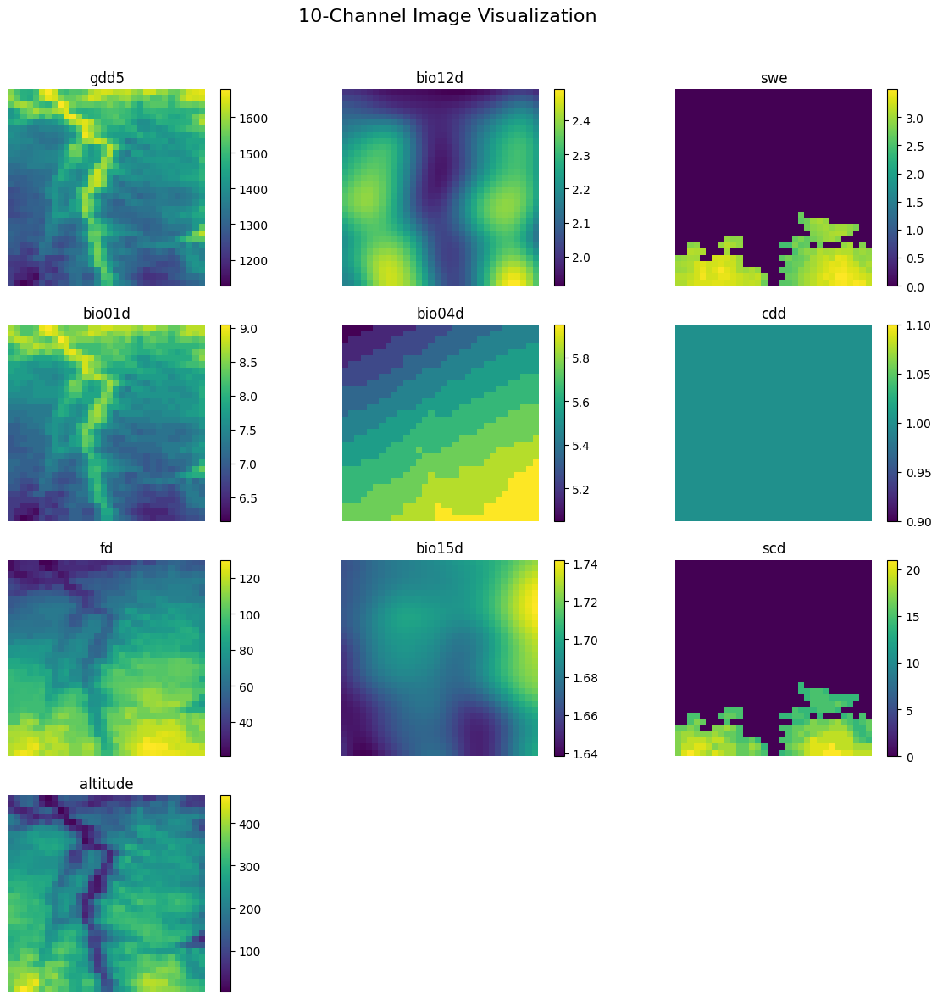

In [20]:
import numpy as np
import matplotlib.pyplot as plt

# Example 10-channel image (Replace with your actual data)
image_10ch = sampled_grids_climatic.iloc[44].climatic_map  # Shape (Height, Width, 10)

# Set up a 4-row, 3-column grid for 10 channels (12 slots total)
fig, axes = plt.subplots(4, 3, figsize=(12, 12))
fig.suptitle("10-Channel Image Visualization", fontsize=16)

# Flatten axes for easier indexing
axes = axes.flatten()

# Create a color map
cmap = plt.get_cmap("viridis")

# List of variable names
variable_names = variables.copy()  # Avoid modifying the original list
variable_names.append('altitude')  # Now length = 10

# Loop over the 10 channels
for i in range(10):
    ax = axes[i]
    img = ax.imshow(image_10ch[:, :, i], cmap=cmap)
    ax.set_title(f"{variable_names[i]}")
    ax.axis("off")
    fig.colorbar(img, ax=ax, orientation='vertical')

# Turn off the remaining unused subplots (slots 10 and 11)
for j in range(10, len(axes)):
    axes[j].axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
plt.show()


### Calculating species Richness

#### Loading Requirements

In [3]:
import json
import random

from tqdm import tqdm
import sys

import geopandas as gpd
from shapely.geometry import Point

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Import PyTorch
import torch
from torch import nn
import torch.optim as optim
import  torchvision.transforms as transforms

# Import torchvision 
import torchvision
from torchvision import datasets
from torchvision.transforms import ToTensor
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torchvision import models, transforms

In [4]:
seed = 42  # Choose any number

# Set seed for PyTorch
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)  # If using CUDA
torch.cuda.manual_seed_all(seed)  # If using multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Set seed for NumPy and Python's random module
np.random.seed(seed)
random.seed(seed)

In [5]:
# Load from JSON file
with open(r"../data/species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)

In [6]:
class MultiLabelDatasetRescale(Dataset):
    def __init__(self):
        # self.x_train, self.x_val, self.x_test, self.y_train, self.y_val, self.y_test = None, None, None, None, None, None
        self.mode = 'test'
        
         # Stack and convert to float32 tensor
        raw_images = torch.tensor(np.stack(df_2020_resampled['climatic_map'].values).astype(np.float32))  # shape: [N, H, W, C]
        # self.labels = torch.tensor(np.stack(df_2018_resampled['species_vector'].values).astype(np.float32))

        # Transpose to  [C, H, W] for PyTorch
        # raw_images = raw_images.permute(2, 0, 1)
        raw_images = raw_images.permute(0, 3, 1, 2)

                # === NORMALIZE EACH CHANNEL INDEPENDENTLY ===
        # These must match the order of your channels!

        #2018
        mins = torch.tensor([
            1.9000409841537476,          # gdd5
            0.9102739691734314,          # bio12d
            0.009359435178339481,         # swe
            -9.149993896484375,          # bio01d
            3.1500244140625,             # bio04d
            0.0,                         # cdd
            0.0,                         # fd
            1.0523613691329956,          # bio15d
            0.0,                         # scd
            0.0,                         # altitude
        ])

        maxs = torch.tensor([
            3858.301513671875, # gdd5
            21.650711059570312, #bio12d
            113.7122802734375, # swe
            10.45001220703125, #bio01d
            157.55001831054688, #bio04d
            8.0, #cdd
            362.0, # fd
            2.7762691974639893, #bio15d
            365.0, # scd
            2296.0, #altitude
        ])

        #2019

        # mins = torch.tensor([
        #     1.9000409841537476,          # gdd5
        #     0.7241,          # bio12d
        #     0.009359435178339481,         # swe
        #     -9.149993896484375,          # bio01d
        #     3.1500244140625,             # bio04d
        #     0.0,                         # cdd
        #     0.0,                         # fd
        #     1.0523613691329956,          # bio15d
        #     0.0,                         # scd
        #     0.0,                         # altitude
        # ])

        # maxs = torch.tensor([
        #     3858.301513671875, # gdd5
        #     21.650711059570312, #bio12d
        #     113.7122802734375, # swe
        #     10.45001220703125, #bio01d
        #     157.55001831054688, #bio04d
        #     8.0, #cdd
        #     362.0, # fd
        #     2.7762691974639893, #bio15d
        #     365.0, # scd
        #     2296.0, #altitude
        # ])

        # 2020

        # mins = torch.tensor([
        #     1.9000,          # gdd5
        #     0.1483,          # bio12d
        #     0,         # swe
        #     -9.149993896484375,          # bio01d
        #     3.1500,             # bio04d
        #     0.0,                         # cdd
        #     0.0,                         # fd
        #     0,          # bio15d
        #     0.0,                         # scd
        #     0.0,                         # altitude
        # ])

        # maxs = torch.tensor([
        #     3858.301513671875, # gdd5
        #     21.650711059570312, #bio12d
        #     113.7122802734375, # swe
        #     10.45001220703125, #bio01d
        #     157.55001831054688, #bio04d
        #     8.0, #cdd
        #     362.0, # fd
        #     2.7762691974639893, #bio15d
        #     365.0, # scd
        #     2296.0, #altitude
        # ])
        

        # Avoid division by zero (e.g., for crs with constant 0)
        ranges = maxs - mins
        ranges[ranges == 0] = 1  # Prevent division by zero

        # Apply scaling: (x - min) / (max - min)
        # self.images = (raw_images - mins.view(-1, 1, 1)) / ranges.view(-1, 1, 1)

        
        self.images = (raw_images - mins.view(1, -1, 1, 1)) / ranges.view(1, -1, 1, 1)
        self.idx = df_2020_resampled.index.to_list()
        
    def __len__(self):
        if self.mode == 'test':
            
            return len(self.images)


    def __getitem__(self, idx):
        if self.mode == 'test':
            sample = {'images': self.images[idx], 'index': self.idx[idx]}

        return sample

In [7]:
import torch.nn.functional as F
import torch.distributed as dist
import argparse

class CustomLoss(nn.Module):
    def __init__(self, loss_fn, args):
        super(CustomLoss, self).__init__()
        self.loss_fn = loss_fn
        self.weighted = args.weighted
        self.args = args
        if self.weighted:
            self.samples_per_cls = list(args.train_label_cnt.values())
            self.no_of_classes = args.num_classes

    def compute_weights(self, labels, beta=0.9999):
        effective_num = 1.0 - np.power(beta, self.samples_per_cls)
        weights = (1.0 - beta) / np.array(effective_num)
        weights = weights / weights.sum() * self.no_of_classes
        labels_one_hot = labels

        weights = torch.tensor(weights).float().to(self.args.device, non_blocking=True)
        weights = weights.unsqueeze(0)
        weights = weights.repeat(labels_one_hot.shape[0],1) * labels_one_hot
        
        return weights
    
    def forward_focal(self, logits, labels,alpha=0.999,gamma=2.0):
        p = torch.sigmoid(logits)
        ce_loss = F.binary_cross_entropy_with_logits(logits, labels, reduction="none")
        p_t = p * labels + (1 - p) * (1 - labels)
        loss = ce_loss * ((1 - p_t) ** gamma)
        
        if self.weighted:
            weights = self.compute_weights(labels)
            weights_t = weights * labels * alpha + (1 - labels) * (1 - alpha)
            weighted_loss = weights_t * loss
            focal_loss = weighted_loss.mean()
        
        else:
            alpha_t = alpha * labels + (1 - alpha) * (1 - labels)
            focal_loss = alpha_t * loss
            focal_loss = focal_loss.mean()
        
        return focal_loss

    
    def forward_bce(self, logits, labels):
        if self.weighted:
            weights = self.compute_weights(labels)
            bce_loss = F.binary_cross_entropy_with_logits(logits, labels, pos_weight = weights)
        else:
            bce_loss = F.binary_cross_entropy_with_logits(logits, labels)
        
        return bce_loss
    
    
    def forward_dice(self, logits, labels):
        p = torch.sigmoid(logits)
        smooth = 1.0
        intersection = (p * labels).sum(0)
        total = (p**2 + labels**2).sum(0)
        dice_loss = 1 - (intersection + smooth)/(total + smooth)
        
        return dice_loss.mean()
    
    
    def forward(self, logits, labels):
        if self.loss_fn == 'bce':
            return self.forward_bce(logits, labels)
        elif self.loss_fn == 'focal':
            return self.forward_focal(logits, labels)
        elif self.loss_fn == 'dice':
            return self.forward_dice(logits, labels)

In [8]:
class CustomResNet18(nn.Module):
    def __init__(self, num_classes):
        super(CustomResNet18, self).__init__()

        # Load Pretrained ResNet18
        self.resnet = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
        
        # Replace ReLU activations with inplace=False to avoid in-place modification issues
        # self.resnet.relu = nn.ReLU(inplace=False)

        # Modify the first convolutional layer to accept 11 channels instead of 3
        self.resnet.conv1 = nn.Conv2d(10, 64, kernel_size=7, stride=2, padding=3, bias=False)

        # Access layers up to the last block of layer4
        # self.features_conv = self.resnet.layer4[-1]  # Excluding the last block in layer4
        self.hook = self.resnet.layer3[-1].conv2.register_forward_hook(self.hook_fn)
        self.activations = None

        # Modify the final fully connected layer to match the number of classes     
        self.in_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Linear(self.in_features, num_classes)

        # Freeze all layers initially
        for param in self.resnet.parameters():
            param.requires_grad = False

        # Placeholder for gradients
        self.gradients = None

    # Hook for capturing gradients during backward pass
    def activations_hook(self, grad):
        self.gradients = grad
        
    def hook_fn(self, module, input, output):
        # Store activations from the last convolutional layer
        self.activations = output
        
    # Forward pass through the network
    def forward(self, x):
        # Pass through the layers until the last convolutional block
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)

        # Register the hook on the output of the last convolutional layer (conv2 of the last block)
        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)
        
        # Register hook on the output of the last convolutional layer in layer4[1]
        x.requires_grad_()  # Enable gradient computation for this tensor
        h = x.register_hook(self.activations_hook)
        
        # Continue through the network
        x = self.resnet.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.resnet.fc(x)
        
        return x
    
    def get_embedding(self, x):
        # Forward pass up to avgpool
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)

        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)

        x = self.resnet.avgpool(x)
        x = torch.flatten(x, 1)  # Shape: [batch_size, 2048]
        return x
    
    # Method to get the captured gradients
    def get_activations_gradient(self):
        return self.gradients

    # Method to get activations from the last convolutional layer (optional)
    def get_activations(self):
        return self.activations
    

#### Evaluating the model

In [9]:
# Load the NumPy array from the pickle file
# with open('../models/old_no_norm/thresholds_focal_RESNET18_49_tss_2017.pkl', 'rb') as f:
#     loaded_thresholds = pickle.load(f)

with open('../models/thresholds_FOCAL_RESNET18_55_tss_1991-2017_full_v2.pkl', 'rb') as f:
    loaded_thresholds = pickle.load(f)
global_threshold = np.mean(loaded_thresholds[np.isfinite(loaded_thresholds)])
global_threshold
# with open('../models/thresholds_BCE_60_tss.pkl', 'rb') as f:
#     loaded_thresholds = pickle.load(f)

np.float32(0.5082911)

In [10]:
PATH = '../models/RESNET18_55_FOCAL_tss_1991-2017_full_v2'
# PATH = '../models/old_no_norm/RESNET18_49_tss_2017'

In [12]:
num_classes = 1819
# device = torch.device('cuda:0')
device = torch.device('cpu')
MODEL = CustomResNet18(num_classes=num_classes).to(device)
# MODEL = CNNModel_1(11,32,num_classes).to(device)

# MODEL.load_state_dict(torch.load(PATH, weights_only=True)) # if GPU is available


MODEL.load_state_dict(torch.load(PATH, weights_only=True, map_location=torch.device(device)))
# model.to(args.device) 
MODEL.eval()

CustomResNet18(
  (resnet): ResNet(
    (conv1): Conv2d(10, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, tr

In [13]:
with open('../data/species_counts_filtered_10_1991_2017.json', 'r') as f:
    class_counts_dict = json.load(f)

In [14]:
# Example args (you can replace it with your actual arguments)
class Args:
    def __init__(self):
        self.weighted = True  # Set to False if no class weighting is needed
        self.train_label_cnt = class_counts_dict  # Example class counts
        self.num_classes = 1819  # Binary classification
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.model_type = 'CNN'
        self.eval = False
        # self.thres_method = 'adaptive'
        self.thres_method = 'global'
        self.threshold = global_threshold

In [15]:
# Function to set the seed for each worker
def seed_worker(worker_id):
    # Set seed for Python and NumPy in each worker
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

In [16]:
with open(r'../data/Full_Scale/sampled_grids_bin_008_2018.pkl', "rb") as file_2:
    df_2020_resampled = pickle.load(file_2)
df_2020_resampled

,geometry,latitude,longitude,climatic_map
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 3.3047945, 0.0, 9.25, 5.6500244,..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 3.2803288, 0.0, 9.25, 5.75, 3.0,..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 3.1708493, 0.0, 9.25, 5.6500244,..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 3.171315, 0.0, 9.25, 5.850006, 2..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 3.1373425, 0.0, 9.25, 5.950012, ..."
...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 3.6369588, 7.25763, 3.350006, 6...."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 2.9027944, 5.537686, 4.0500183, 6..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 3.4682465, 6.837236, 3.350006, 6...."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 3.8488493, 9.09052, 2.6500244, 6..."


In [17]:

args = Args()
mlc_dataset = MultiLabelDatasetRescale()

print(len(mlc_dataset))
# mlc_dataset.train_val_test_split()
dataloader = DataLoader(mlc_dataset, batch_size = 32, shuffle = False, worker_init_fn=seed_worker)

11470


In [18]:
def species_vectors(model, eval_loader, criterion, thresholds, args):
    model.eval()
    # eval_loss = []
    all_preds = {}

    with torch.no_grad():
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            # targets = batch['labels'].to(args.device, non_blocking=True)
            index = batch['index'].to(args.device, non_blocking=True)
            
            outputs = model(samples)
            # loss = criterion(outputs, targets)
            # eval_loss.append(loss.item())

            # Threshold logic
            if args.thres_method == 'adaptive':
                thresholds_tensor = torch.tensor(thresholds, dtype=torch.float32).to(args.device)
            elif args.thres_method == 'global':
                thresholds_tensor = torch.tensor([args.threshold] * outputs.shape[1], dtype=torch.float32).to(args.device)
            else:
                raise ValueError("Unknown threshold method")

            probs = torch.sigmoid(outputs)
            preds = (probs >= thresholds_tensor).float()

            # Append each prediction individually to the list
            for i, pred in zip(index, preds):
                index_number = i.item()

                # print(index_number)
                all_preds[index_number] = pred.cpu().numpy()

    return all_preds

In [19]:
prob_dic = species_vectors(model = MODEL,eval_loader = dataloader, criterion = CustomLoss('focal', args), thresholds = loaded_thresholds, args = Args())


In [20]:
# Wrap each vector in a list so it stays in a single column
preds_df = pd.DataFrame({
    "predicted_vector": [v for v in prob_dic.values()]
}, index=prob_dic.keys())
preds_df

,predicted_vector
0,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
1,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
2,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
3,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
4,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
...,...
11465,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11466,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11467,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11468,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [21]:
df_2020_with_preds = df_2020_resampled.join(preds_df, how='left')
df_2020_with_preds

,geometry,latitude,longitude,climatic_map,predicted_vector
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 3.3047945, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 3.2803288, 0.0, 9.25, 5.75, 3.0,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 3.1708493, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 3.171315, 0.0, 9.25, 5.850006, 2...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 3.1373425, 0.0, 9.25, 5.950012, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 3.6369588, 7.25763, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 2.9027944, 5.537686, 4.0500183, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 3.4682465, 6.837236, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 3.8488493, 9.09052, 2.6500244, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [22]:
def calculate_sp_richness(species_vectors):
    richness = []
    for i in species_vectors:
        nonzero = np.count_nonzero(i)
        richness.append(nonzero)
    return richness
# df_2018_with_preds['true_richness'] = calculate_sp_richness(df_2018_with_preds['species_vector'])    
df_2020_with_preds['predicted_richness'] = calculate_sp_richness(df_2020_with_preds['predicted_vector'])    
df_2020_with_preds

,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 3.3047945, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",735
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 3.2803288, 0.0, 9.25, 5.75, 3.0,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",698
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 3.1708493, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",775
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 3.171315, 0.0, 9.25, 5.850006, 2...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",754
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 3.1373425, 0.0, 9.25, 5.950012, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",770
...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 3.6369588, 7.25763, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",259
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 2.9027944, 5.537686, 4.0500183, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",254
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 3.4682465, 6.837236, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",252
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 3.8488493, 9.09052, 2.6500244, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",251


In [23]:
def points_species_richness_plot(df, column_name):
    # Load the shapefile of Norway's boundaries
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Assuming 'df' contains your data with species richness in 'column_name' column
    # Step 1: Create GeoDataFrame from the DataFrame
    result_geo_df = gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
     # ✅ Create new figure and axis
    fig, ax = plt.subplots(figsize=(8, 10))
    # Step 2: Plot the map
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Step 3: Plot the points with species richness as colors
    result_geo_df.plot(
        ax=ax, 
        column=column_name,  # Use the column passed to the function
        cmap='YlGnBu',  # Colormap for heatmap, you can try others like 'viridis', 'plasma', etc.
        markersize=3, 
        legend=True,  # Add legend for color scale
        alpha=0.7  # Make points slightly transparent for better visualization
    )
    
    # Customize plot
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.set_title(f"Predicted Species Richness in Norway (2018)", fontsize=15)
    plt.tight_layout()
    # plt.savefig('../Images/SpeciesRichness_11000_samples.png')
    # Show the plots
    plt.show()

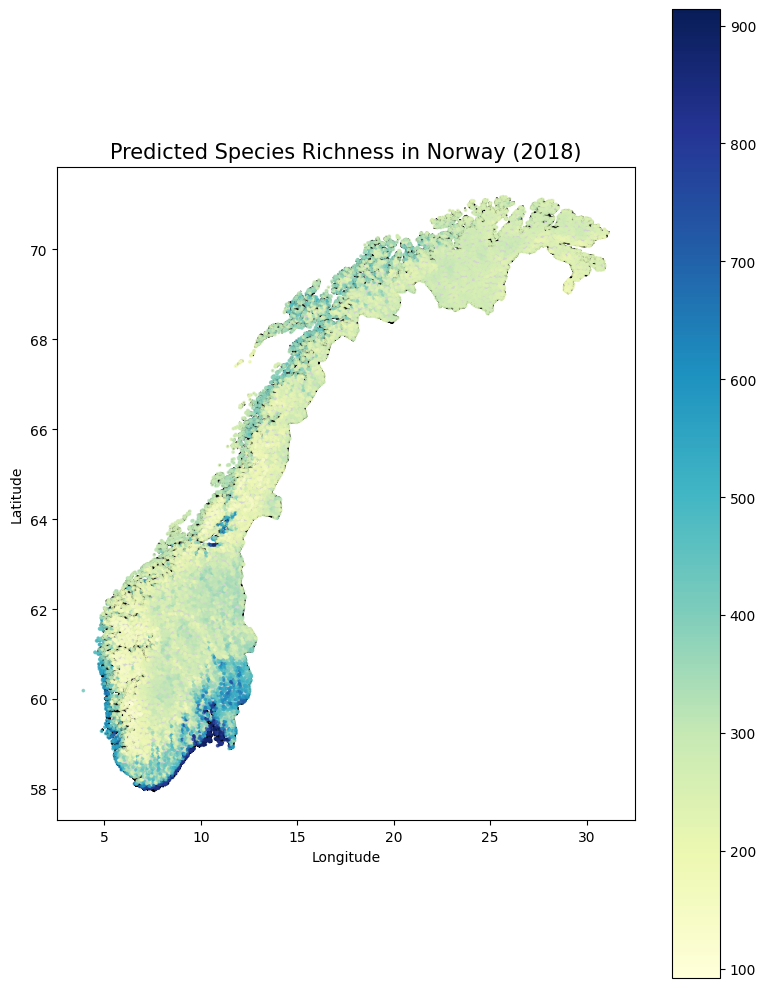

In [24]:
# Plot the predicted richness on the second subplot
points_species_richness_plot(df=df_2020_with_preds, column_name='predicted_richness')

### Redlisted SP Richness

In [27]:
# !pip install openpyxl
df_redlist = pd.read_excel(r'../data/interesting species.xlsx')
df_redlist

ImportError: Missing optional dependency 'openpyxl'.  Use pip or conda to install openpyxl.

In [ ]:
# Filter rows where 'Kategori 2021' is CR, EN, or VU
redlisted_sp_df = df_redlist[df_redlist['Kategori 2021'].isin(['CR', 'EN', 'VU'])]
redlisted_species_list = redlisted_sp_df['Vitenskapelig navn'] 
redlisted_sp_df

In [ ]:
def points_redlisted_species_richness_plot(df, redlisted_species, species_universe):
    # Step 1: Get indices of redlisted species
    redlisted_indices = [species_universe[sp] for sp in redlisted_species if sp in species_universe]

    # Step 2: Compute red-listed richness per point
    df = df.copy()
    df["redlisted_richness"] = df["predicted_vector"].apply(
        lambda x: sum(x[i] for i in redlisted_indices)
    )

    # Step 3: Remove points with 0 redlisted richness
    df = df[df["redlisted_richness"] > 0]

    # Step 4: Make GeoDataFrame
    gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"
    )

    # Step 5: Plotting
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    fig, ax = plt.subplots(figsize=(8, 10))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    gdf.plot(
        ax=ax,
        column="redlisted_richness",
        cmap="Reds",
        markersize=3,
        legend=True,
        alpha=0.7
    )

    ax.set_title("Red-listed Species Richness in Norway (2018)", fontsize=14)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    plt.tight_layout()
    # plt.savefig(f"../Images/2018 redlist sp in Norway.png")
    plt.show()


In [ ]:
points_redlisted_species_richness_plot(df_2020_with_preds, redlisted_species_list, species_universe)

### Clustering Logits

In [28]:
# !pip install umap-learn
import umap.umap_ as umap
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [29]:
def umap_logits(model, eval_loader): 
    all_embeddings = []
    # all_labels = []
    all_indexes = []
    model.eval()
    with torch.no_grad():
        # for data, targets in tqdm(eval_loader, file=sys.stdout):
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            # labels = batch['labels'].to(args.device, non_blocking=True) 
            indexes = batch['index'].to(args.device, non_blocking=True)
            embeddings = model.get_embedding(samples)
            all_embeddings.append(embeddings.cpu().numpy())
            # all_labels.append(labels.cpu().numpy())
            all_indexes.append(indexes.cpu().numpy())
    # Convert to arrays
    X = np.vstack(all_embeddings)  # Shape: [N_samples, 2048]
    # y = np.concatenate(all_labels)
    ind = np.concatenate(all_indexes)
    reducer = umap.UMAP(n_components=3, random_state=42)
    X_umap = reducer.fit_transform(X)

    return X_umap, ind

In [30]:
umap, ind = umap_logits(model = MODEL,eval_loader = dataloader)

C:\Users\Usuario\miniconda3\envs\pytorch\lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Usuario\miniconda3\envs\pytorch\lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [31]:
ind

array([    0,     1,     2, ..., 11467, 11468, 11469], shape=(11470,))

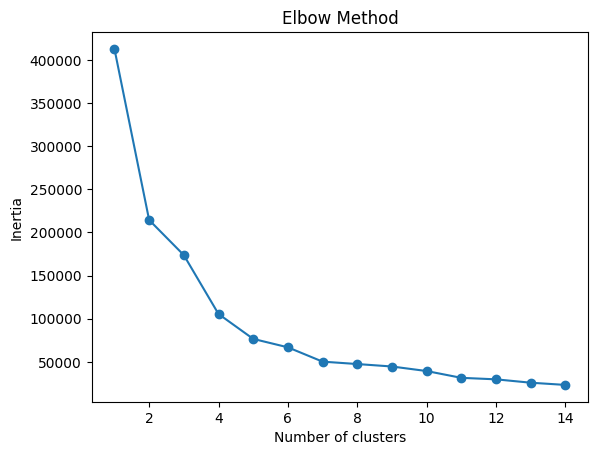

In [32]:
# Optional: Elbow method
inertia = []
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(umap)
    inertia.append(kmeans.inertia_)

plt.plot(range(1, 15), inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
# plt.savefig(f"../Images/Elbow_plot.png")
plt.show()

In [33]:
number_clusters = 6

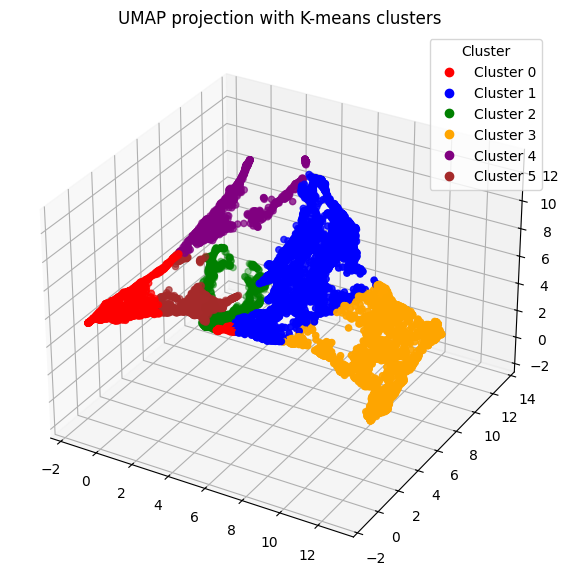

In [34]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap

# Fixed color map
fixed_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
fixed_cmap = ListedColormap(fixed_colors[:number_clusters])

# Clustering
kmeans = KMeans(n_clusters=number_clusters, random_state=42)
clusters = kmeans.fit_predict(umap)

# Plot
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(umap[:, 0], umap[:, 1], umap[:, 2],
                     c=clusters, cmap=fixed_cmap, s=20)
ax.set_title("UMAP projection with K-means clusters")

# Legend (labels = 0 to K-1)
handles, labels = scatter.legend_elements()
ax.legend(handles, [f"Cluster {i}" for i in range(number_clusters)], title="Cluster")

# Save figure
# plt.savefig(f"../Images/k-means_2018.png")
plt.show()


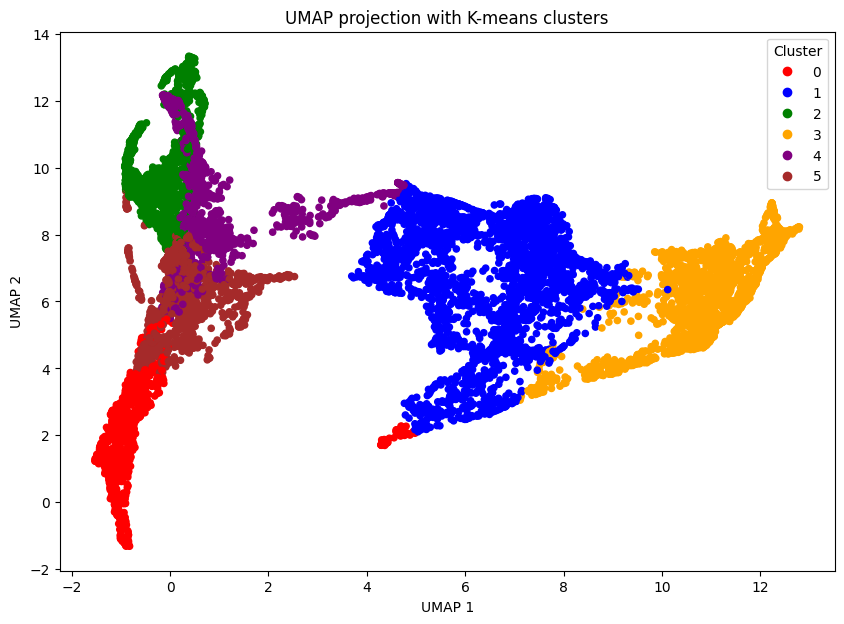

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

# Final model with chosen K
kmeans = KMeans(n_clusters=number_clusters, random_state=42)
clusters = kmeans.fit_predict(umap)

# 2D Plot
plt.figure(figsize=(10, 7))
scatter = plt.scatter(umap[:, 0], umap[:, 1],
                      c=clusters, cmap=fixed_cmap, s=20)
plt.title("UMAP projection with K-means clusters")
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.show()


In [36]:
# Creating umap DF
df_umap = pd.DataFrame(umap, columns=["UMAP1", "UMAP2", "UMAP3"])
df_umap["index"] = ind
df_umap["Cluster"] = clusters

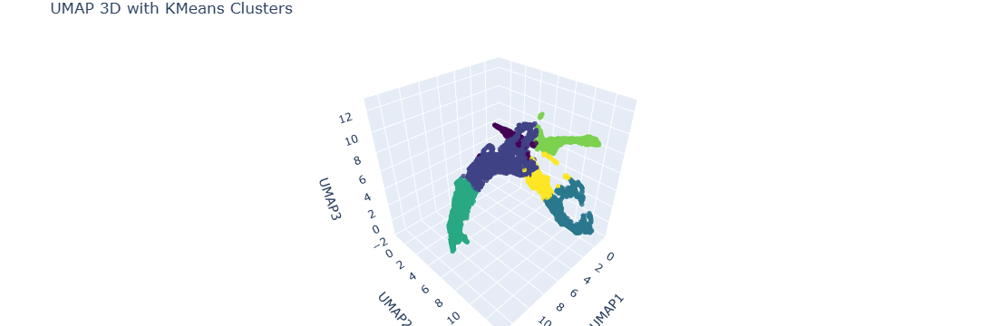

In [37]:

import plotly.graph_objs as go

# Crear figura base
fig = go.Figure(
    data=[go.Scatter3d(
        x=df_umap["UMAP1"],
        y=df_umap["UMAP2"],
        z=df_umap["UMAP3"],
        mode='markers',
        marker=dict(
            size=3,
            color=df_umap["Cluster"],  # Numérico
            colorscale='Viridis',
            opacity=0.8
        ),
        text=df_umap["Cluster"].astype(str),
    )]
)

# Configuración general
fig.update_layout(
    scene=dict(
        xaxis_title='UMAP1',
        yaxis_title='UMAP2',
        zaxis_title='UMAP3'
    ),
    title="UMAP 3D with KMeans Clusters",
    margin=dict(l=0, r=0, b=0, t=30),
)

# No se agregan los frames ni la animación de rotación

fig.show()

# Guardar la figura
# fig.write_html(r"../docs/umap_3d_plot_no_rotate.html")




### Plotting UMAP on MAP

In [38]:
df_2020_with_clusters = df_umap.merge(
    df_2020_with_preds,
    left_on='index',      # 'index' column in df_umap
    right_index=True,     # index in df_2018_with_preds
    how='left'
)
df_2020_with_clusters

,UMAP1,UMAP2,UMAP3,index,Cluster,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,-0.079425,12.718018,1.226549,0,2,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 3.3047945, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",735
1,-0.099890,12.673941,1.280510,1,2,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 3.2803288, 0.0, 9.25, 5.75, 3.0,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",698
2,-0.026443,12.802969,1.072099,2,2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 3.1708493, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",775
3,-0.084744,12.704243,1.236254,3,2,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 3.171315, 0.0, 9.25, 5.850006, 2...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",754
4,-0.070495,12.729883,1.197717,4,2,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 3.1373425, 0.0, 9.25, 5.950012, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",770
...,...,...,...,...,...,...,...,...,...,...,...
11465,10.743871,6.398182,7.340937,11465,3,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 3.6369588, 7.25763, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",259
11466,10.586014,6.063946,7.371744,11466,3,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 2.9027944, 5.537686, 4.0500183, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",254
11467,10.836631,6.344688,7.476008,11467,3,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 3.4682465, 6.837236, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",252
11468,10.763531,6.178179,7.522475,11468,3,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 3.8488493, 9.09052, 2.6500244, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",251


In [39]:
import matplotlib.pyplot as plt
import geopandas as gpd
import matplotlib.cm as cm
import matplotlib.colors as mcolors

def plotting_samples_norway_cluster(df):
    # Load Norway shapefile
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)

    # Create figure and axes
    fig, ax = plt.subplots(figsize=(10, 10))

    # Plot Norway outline
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    # Create GeoDataFrame
    result_geo_df = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"
    )

    # Get sorted unique cluster labels
    clusters = sorted(result_geo_df["Cluster"].unique())

    # Get viridis colormap with N discrete colors
    cmap = fixed_cmap
    colors = [cmap(i) for i in range(len(clusters))]
    cluster_to_color = dict(zip(clusters, colors))

    # Plot each cluster with its color
    for cluster_label in clusters:
        cluster_df = result_geo_df[result_geo_df["Cluster"] == cluster_label]
        cluster_df.plot(
            ax=ax,
            markersize=3,
            label=f"Cluster {cluster_label}",
            color=cluster_to_color[cluster_label],
            alpha=0.8
        )

    # Customize plot
    ax.set_title("Clusterized Bioclimatic regions 2018", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend(title="Cluster", loc="lower right", markerscale=6)
    # plt.savefig(f"../Images/2018 bioclimatic regions in Norway.png")

    plt.show()


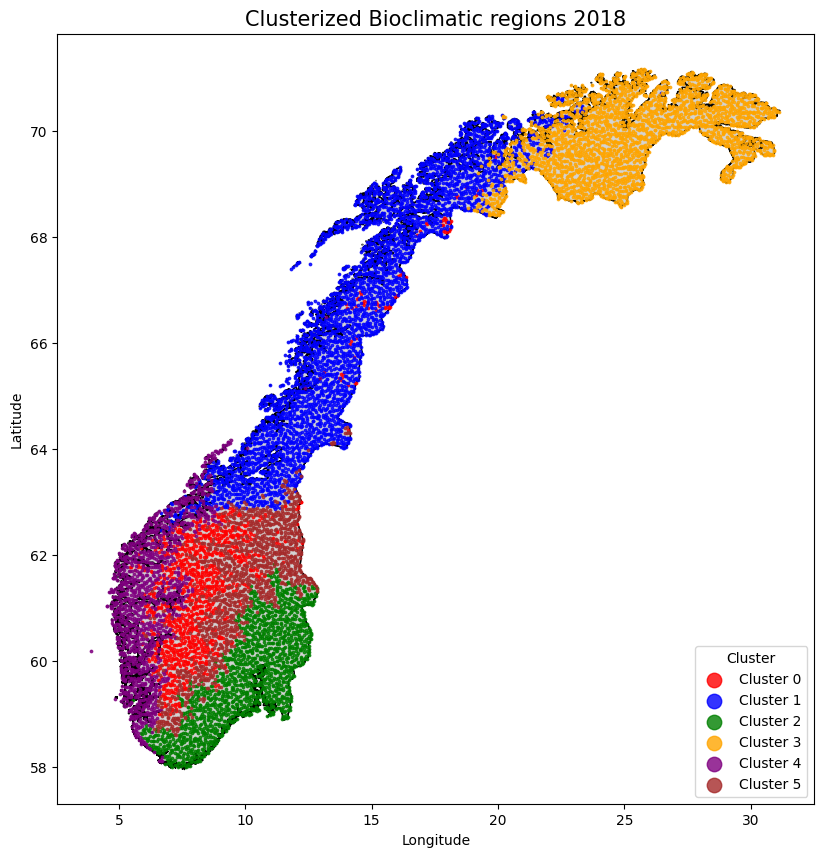

In [40]:
plotting_samples_norway_cluster(df_2020_with_clusters)

Est - west gradient is very strong due to the oceanic influence.

In [41]:
df_2020_with_clusters

,UMAP1,UMAP2,UMAP3,index,Cluster,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,-0.079425,12.718018,1.226549,0,2,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1834.4027, 3.3047945, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",735
1,-0.099890,12.673941,1.280510,1,2,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1838.2527, 3.2803288, 0.0, 9.25, 5.75, 3.0,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",698
2,-0.026443,12.802969,1.072099,2,2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1846.6027, 3.1708493, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",775
3,-0.084744,12.704243,1.236254,3,2,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1867.9026, 3.171315, 0.0, 9.25, 5.850006, 2...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",754
4,-0.070495,12.729883,1.197717,4,2,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1886.9526, 3.1373425, 0.0, 9.25, 5.950012, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",770
...,...,...,...,...,...,...,...,...,...,...,...
11465,10.743871,6.398182,7.340937,11465,3,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 3.6369588, 7.25763, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",259
11466,10.586014,6.063946,7.371744,11466,3,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 2.9027944, 5.537686, 4.0500183, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",254
11467,10.836631,6.344688,7.476008,11467,3,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 3.4682465, 6.837236, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",252
11468,10.763531,6.178179,7.522475,11468,3,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 3.8488493, 9.09052, 2.6500244, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",251


In [42]:
import pandas as pd
import numpy as np

# Assuming 'df' is your DataFrame containing the data with the 'climatic_map' column

# Define a function to calculate the mean per channel
def extract_mean_climatic_map(df):
    # Initialize an empty list to store the results
    mean_values = []

    # Iterate over each row in the dataframe
    for idx, row in df.iterrows():
        # Flatten the climatic_map (assuming it's a list of lists of lists)
        climatic_map = np.array(row['climatic_map'])

        # Compute the mean of the values per channel (assuming each column in the map corresponds to a channel)
        mean_per_channel = climatic_map.mean(axis=(0, 1))  # Mean over the first two dimensions (rows and columns of the map)

        # Store the means for each row
        mean_values.append(mean_per_channel)
        
    variables_list =['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd','alt']


    # Add the mean values as new columns to the dataframe
    mean_values_df = pd.DataFrame(mean_values, columns=[f"{variables_list[i]}" for i in range(mean_values[0].shape[0])])

    # Concatenate the new mean columns to the original dataframe (excluding 'geometry' column)
    df_with_means = pd.concat([df.drop(columns=['geometry']), mean_values_df], axis=1)
    return df_with_means

# Now group by Cluster and calculate the mean for each cluster
df_with_means = extract_mean_climatic_map(df_2020_with_clusters)

# Group by 'Cluster' and calculate the mean of each channel, excluding non-numeric columns
grouped_means = df_with_means.drop(columns=['index','latitude', 'longitude', 'predicted_vector', 'predicted_richness']).groupby('Cluster').mean()




In [43]:
df_with_means

,UMAP1,UMAP2,UMAP3,index,Cluster,latitude,longitude,climatic_map,predicted_vector,predicted_richness,gdd5,bio12d,swe,bio01d,bio04d,cdd,fd,bio15d,scd,alt
0,-0.079425,12.718018,1.226549,0,2,58.028287,6.997755,"[[[1834.4027, 3.3047945, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",735,1812.531860,3.806501,1.356482,8.805695,6.236420,2.361328,44.620117,1.703406,13.768555,39.381836
1,-0.099890,12.673941,1.280510,1,2,58.022171,7.050138,"[[[1838.2527, 3.2803288, 0.0, 9.25, 5.75, 3.0,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",698,1822.267700,3.718071,1.374537,8.823449,6.276072,2.208984,45.326172,1.709676,14.324219,39.798828
2,-0.026443,12.802969,1.072099,2,2,57.990907,7.086381,"[[[1846.6027, 3.1708493, 0.0, 9.25, 5.6500244,...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",775,1840.474487,3.532399,0.923731,8.947529,6.195013,2.257812,39.682617,1.713880,9.980469,28.430664
3,-0.084744,12.704243,1.236254,3,2,58.026571,7.219693,"[[[1867.9026, 3.171315, 0.0, 9.25, 5.850006, 2...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",754,1849.146240,3.569921,1.756143,8.771567,6.541127,2.003906,56.985352,1.722211,19.516602,62.408203
4,-0.070495,12.729883,1.197717,4,2,58.029728,7.285729,"[[[1886.9526, 3.1373425, 0.0, 9.25, 5.950012, ...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",770,1873.404175,3.462507,1.865121,8.800672,6.660556,2.000000,61.579102,1.727303,21.382812,65.273438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11465,10.743871,6.398182,7.340937,11465,3,71.160690,25.549503,"[[[637.80164, 3.6369588, 7.25763, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",259,605.321106,2.836527,5.965560,3.727733,5.347385,0.000000,132.818359,1.240558,101.516602,70.623047
11466,10.586014,6.063946,7.371744,11466,3,71.160205,25.621730,"[[[759.7518, 2.9027944, 5.537686, 4.0500183, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",254,596.617249,2.941136,6.264194,3.641420,5.372388,0.000000,134.429688,1.246693,103.591797,82.509766
11467,10.836631,6.344688,7.476008,11467,3,71.175275,25.662772,"[[[642.4016, 3.4682465, 6.837236, 3.350006, 6....","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",252,590.704407,2.875904,6.110562,3.677263,5.293183,0.000000,131.271484,1.248073,102.006836,73.997070
11468,10.763531,6.178179,7.522475,11468,3,71.166685,25.790593,"[[[557.50146, 3.8488493, 9.09052, 2.6500244, 6...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",251,594.286804,2.821650,5.976532,3.686936,5.314583,0.000000,131.128906,1.255139,101.441406,64.622070


In [44]:
# Show the result
grouped_means

,UMAP1,UMAP2,UMAP3,climatic_map,gdd5,bio12d,swe,bio01d,bio04d,cdd,fd,bio15d,scd,alt
Cluster,,,,,,,,,,,,,,
0,-0.525530,1.937164,5.023325,"[[[806.4072327044025, 4.845070070333558, 14.11...",761.920593,4.697085,14.144254,0.925508,8.743229,1.358760,225.152573,1.738606,175.126846,1100.393921
1,6.394561,6.891450,7.619781,"[[[937.3432393252504, 4.424698640122562, 8.400...",935.689697,4.434507,8.273774,3.269993,7.816323,0.991971,169.425430,1.490552,122.939972,340.429657
2,-0.111951,9.858457,0.248569,"[[[1708.6828837508028, 2.7716286327874116, 6.1...",1680.119629,2.769287,6.499333,6.146178,9.048003,3.046393,149.803406,2.082662,106.514038,324.989624
3,10.862797,6.050125,3.829306,"[[[746.5985922523962, 2.2330123365115813, 5.36...",731.933228,2.323392,5.582479,0.797037,9.002401,0.079415,209.512161,1.613803,168.124481,315.825836
4,1.071187,8.843198,8.453700,"[[[1337.0150037509377, 6.45160044894036, 7.464...",1321.573364,6.527879,7.940469,6.222494,6.523520,1.643337,119.700409,1.638547,67.939598,342.852905
5,0.378817,6.198580,2.759135,"[[[1027.7584473909324, 3.046964177114521, 8.51...",1013.827515,3.023392,8.396912,2.204058,9.339545,1.915758,206.252838,1.845672,155.391571,866.741211


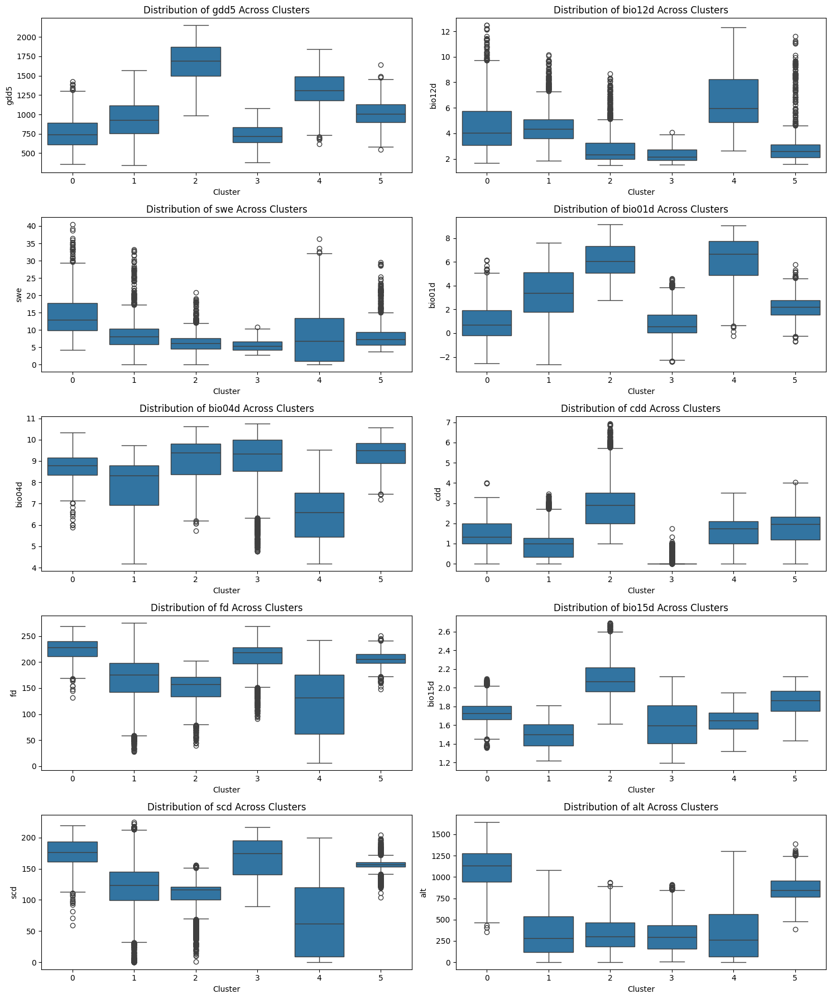

In [45]:
# List of variables
variables = ['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'alt']

# Create a figure and axes for the boxplots
fig, axes = plt.subplots(5, 2, figsize=(15, 18))  # 4 rows and 3 columns for a total of 12 plots
axes = axes.flatten()  # Flatten to easily index the axes

# Loop over each variable and create a boxplot
for i, var in enumerate(variables):
    sns.boxplot(x='Cluster', y=var, data=df_with_means, ax=axes[i])
    axes[i].set_title(f'Distribution of {var} Across Clusters')
    axes[i].set_xlabel('Cluster')
    axes[i].set_ylabel(var)

# Adjust layout
plt.tight_layout()
# plt.savefig(f"../Images/2018_variables_distribution.png")
plt.show()

C:\Users\Usuario\AppData\Local\Temp\ipykernel_5964\947252897.py:31: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\Usuario\AppData\Local\Temp\ipykernel_5964\947252897.py:31: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\Usuario\AppData\Local\Temp\ipykernel_5964\947252897.py:31: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\Usuario\AppData\Local\Temp\ipykernel_5964\947252897.py:31: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the sam

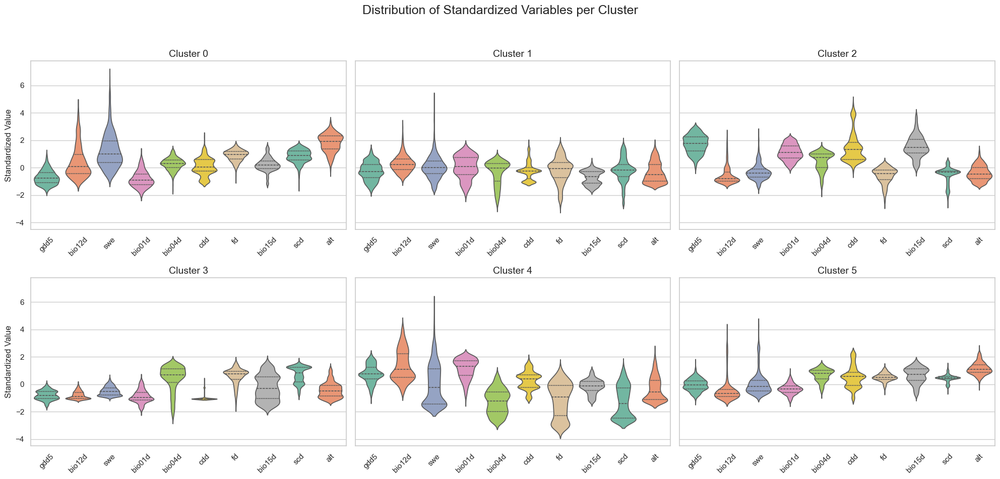

In [50]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.preprocessing import StandardScaler

# List of variables
variables = ['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'alt']

# Standardize the variables for comparability
scaler = StandardScaler()
df_scaled = df_with_means.copy()
df_scaled[variables] = scaler.fit_transform(df_scaled[variables])

# Melt the DataFrame to long format
df_long = df_scaled.melt(id_vars='Cluster', value_vars=variables,
                         var_name='Variable', value_name='Value')

# Get sorted unique clusters
clusters = sorted(df_long['Cluster'].unique())

# Set plot style
sns.set(style="whitegrid", palette="muted")

# Create subplots
fig, axes = plt.subplots(2, 3, figsize=(20, 10), sharey=True)
axes = axes.flatten()

for i, cluster in enumerate(clusters):
    ax = axes[i]
    df_cluster = df_long[df_long['Cluster'] == cluster]
    sns.violinplot(x='Variable', y='Value', data=df_cluster, ax=ax,
                   inner='quartile', palette='Set2')
    ax.set_title(f'Cluster {cluster}', fontsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Standardized Value', fontsize=12)
    ax.tick_params(axis='x', rotation=45)

# Remove unused axes if less than 6 clusters
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle('Distribution of Standardized Variables per Cluster', fontsize=18)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.savefig(f"../Images/2018_violin_cluster_variables_distribution.png")

plt.show()


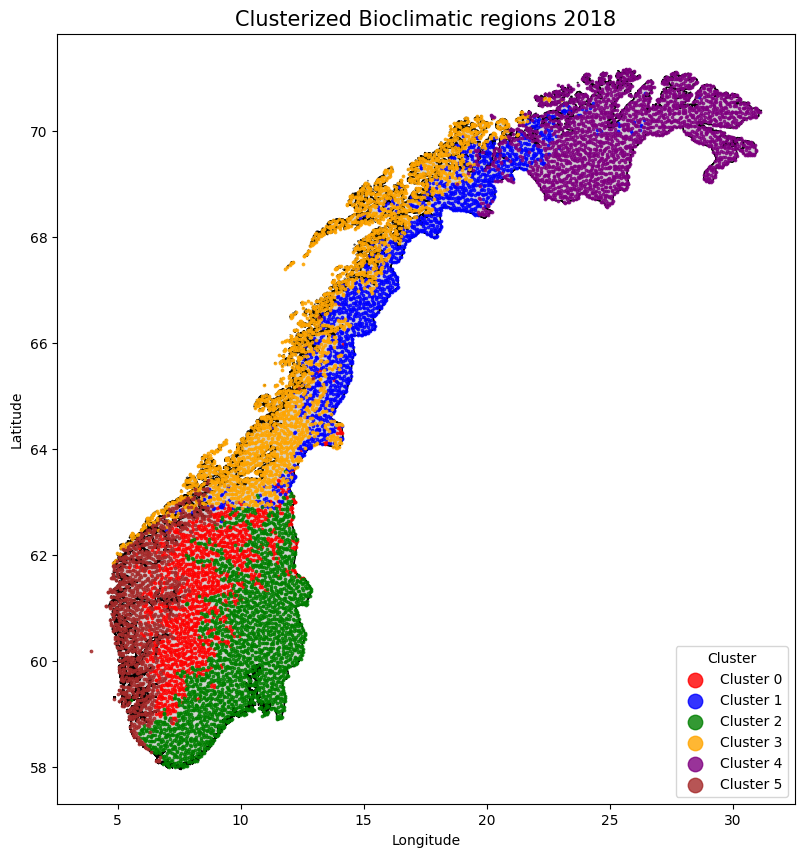

In [67]:
plotting_samples_norway_cluster(df_2020_with_clusters)

### Integrated Gradients

In [68]:
# Load from JSON file
with open(r"../data/species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)
# Filter for Salix species and get their indexes
salix_indexes = {species: index for species, index in species_universe.items() if species.lower().startswith('salix')}

# Show the result
print(salix_indexes)

{'Salix myrsinifolia': 175, 'Salix polaris': 243, 'Salix myrtilloides': 411, 'Salix phylicifolia': 419, 'Salix smithiana': 569, 'Salix lanata': 656, 'Salix viminalis': 663, 'Salix arbuscula': 739, 'Salix pentandra': 786, 'Salix daphnoides': 793, 'Salix hastata': 838, 'Salix gmelinii': 847, 'Salix starkeana': 912, 'Salix caprea': 987, 'Salix lapponum': 996, 'Salix reticulata': 1060, 'Salix myrsinites': 1176, 'Salix meyeriana': 1222, 'Salix alba': 1257, 'Salix repens': 1337, 'Salix fragilis': 1341, 'Salix purpurea': 1417, 'Salix glauca': 1510, 'Salix triandra': 1553, 'Salix cinerea': 1559, 'Salix aurita': 1730, 'Salix herbacea': 1795}


In [69]:
def extract_position(model, eval_loader, name, criterion,thresholds,args): 
    selected_images = []
    sp_index = species_universe[name]
    # eval_loss = []
    model.eval()
    with torch.no_grad():
        # for data, targets in tqdm(eval_loader, file=sys.stdout):
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            outputs = model(samples)
                
            # targets = batch['labels'].to(args.device, non_blocking=True)            
            # loss = criterion(outputs, targets)
            # eval_loss.append(loss.item())
            
            if args.thres_method == 'adaptive':
                # thresholds = torch.load(args.output_dir.joinpath('thresholds_train.pth'))
                thresholds = torch.tensor(thresholds, dtype=torch.float32).to(args.device)
                # thresholds = torch.tensor(thresholds).to(args.device)
            elif args.thres_method == 'global':
                thresholds = args.threshold
            
            prob = torch.sigmoid(outputs) >= thresholds
            # label = targets >= thresholds
            
            # print('prob',prob)
            # print('prob shape',prob.shape)

            # print('label',label)
            # print(samples.shape[0])
            # Go through the batch
            for i in range(samples.shape[0]):
                if prob[i][sp_index]:
                    selected_images.append(samples[i].cpu())  



        # eval_loss = torch.tensor(eval_loss).mean().item()

        return selected_images
    

In [72]:
name_sp = 'Salix reticulata'
selected_images = extract_position(model = MODEL,eval_loader = dataloader,
                          name =name_sp, 
                          criterion = CustomLoss('focal', args), 
                          thresholds = loaded_thresholds, 
                          args = Args())

In [73]:
len(selected_images),selected_images

(5522,
 [tensor([[[0.3044, 0.2792, 0.2605,  ..., 0.2236, 0.2174, 0.2121],
           [0.3130, 0.2938, 0.2828,  ..., 0.2255, 0.2191, 0.2163],
           [0.3183, 0.2952, 0.2719,  ..., 0.2305, 0.2315, 0.2287],
           ...,
           [0.1893, 0.1875, 0.1796,  ..., 0.2215, 0.2220, 0.2265],
           [0.1866, 0.1833, 0.1770,  ..., 0.2261, 0.2105, 0.1924],
           [0.2299, 0.2190, 0.2012,  ..., 0.2407, 0.2323, 0.2309]],
  
          [[0.3072, 0.3170, 0.3285,  ..., 0.2840, 0.2861, 0.2890],
           [0.3080, 0.3140, 0.3221,  ..., 0.2834, 0.2857, 0.2881],
           [0.3088, 0.3143, 0.3236,  ..., 0.2811, 0.2810, 0.2831],
           ...,
           [0.3224, 0.3228, 0.3272,  ..., 0.2960, 0.2825, 0.2694],
           [0.3234, 0.3240, 0.3276,  ..., 0.2869, 0.2797, 0.2752],
           [0.3154, 0.3178, 0.3223,  ..., 0.2733, 0.2659, 0.2578]],
  
          [[0.1559, 0.1617, 0.1664,  ..., 0.1493, 0.1511, 0.1806],
           [0.1568, 0.1598, 0.1632,  ..., 0.1486, 0.1501, 0.1518],
           [0.1

In [74]:
# !pip install captum
from captum.attr import IntegratedGradients

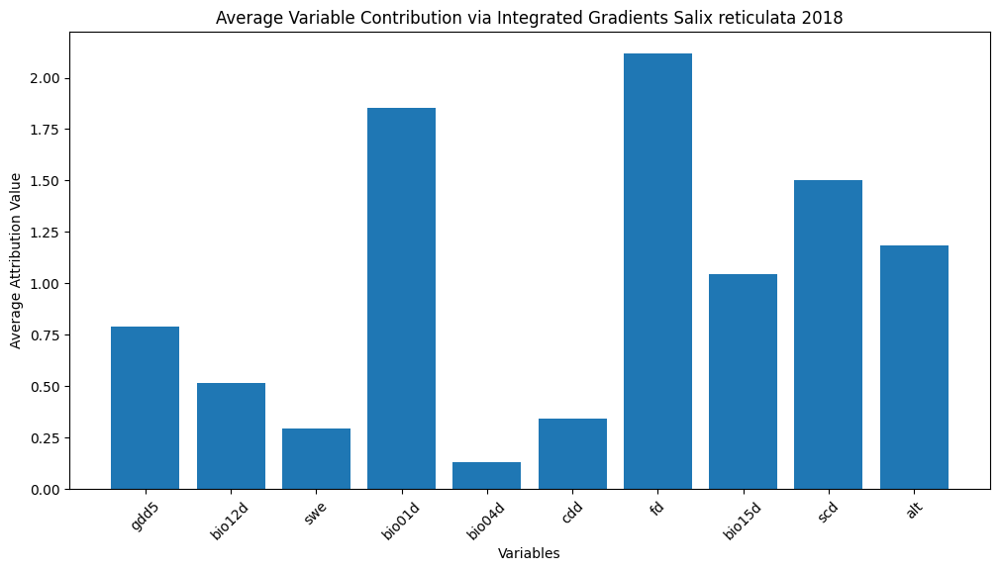

In [77]:
### Modificar para que printe ya directamente en la imagen el titulo de la target Sp

# Move the model to CPU (if it is on GPU)
MODEL = MODEL.to(device)

# Assuming selected_images is the list of images from your function
images_tensor = torch.stack(selected_images).to(device)  # Move to CPU

# List to store the attribution values for each image
all_channel_attributions = []
ig = IntegratedGradients(MODEL)

x = 0
# Loop through each image one by one
for img in selected_images:
    # Move the image to the correct device
    img_tensor = img.unsqueeze(0).to(device)  # Add batch dimension and move to device
    img_tensor.requires_grad_() # recomputar grafico con ordenador xavier
    # Calculate the attribution for the image (target the specific species index, e.g., 1060 for Salix)
    attributions, delta = ig.attribute(img_tensor, target=[1060], return_convergence_delta=True)

    # Aggregate the attribution by summing over height and width
    channel_attributions = torch.sum(torch.abs(attributions), dim=(2, 3))  # Sum over height and width for each channel

    # Convert to numpy and store it
    all_channel_attributions.append(channel_attributions.detach().cpu().numpy())
    x+=1
    # print(f'image {x} computed')

# Convert the list to a numpy array for easier averaging
all_channel_attributions = np.array(all_channel_attributions)

# Calculate the average attribution across all images (axis 0 is the batch dimension)
average_attributions = np.mean(all_channel_attributions, axis=0)

# Plot the average attribution values for each channel
plt.figure(figsize=(12, 6))
plt.bar(range(len(average_attributions[0])), average_attributions[0], tick_label=variables)
plt.title(f'Average Variable Contribution via Integrated Gradients {name_sp} 2018')
plt.xlabel('Variables')
plt.xticks(rotation=45)
plt.ylabel('Average Attribution Value')
plt.savefig(f"../Images/Attributions_{name_sp}_2018.png")
plt.show()



We can see that for salix reticulata the most important variables are the frost days (fd), the mean annual air temperature (bio01d) and the snow cover days (scd) as it is a specie that lives on alpine exposed areas with low snow accumulation.

### Plotting 1 species distribution

In [78]:
def plotting_one_species_distribution_norway(df, sp_name):    
    # Load the shapefile of Norway's boundaries (assuming you have this shapefile)
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Get the index of the species in the species_universe
    index = species_universe[sp_name]
    
    # Create a boolean mask to filter rows where the species is present (predicted_vector[index] == 1)
    mask = df['predicted_vector'].apply(lambda x: x[index] == 1)  # Check if species is present in predicted_vector
    
    # Apply the mask to filter the DataFrame
    filtered_df = df[mask]
    filtered_df
    
    # Step 3: Plot the map
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Convert the filtered DataFrame into a GeoDataFrame
    result_geo_df = gpd.GeoDataFrame(
        filtered_df, 
        geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
    
    # Plot the filtered points where the species is present
    result_geo_df.plot(ax=ax, markersize=3, color='red', alpha=0.5, label=f"{sp_name} Presence")
    
    # Customize plot
    ax.set_title(f"{sp_name} Distribution in Norway 2018", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    plt.savefig(f"../Images/{sp_name} Distribution in Norway 2018.png")   
    # Show the plot
    plt.show()

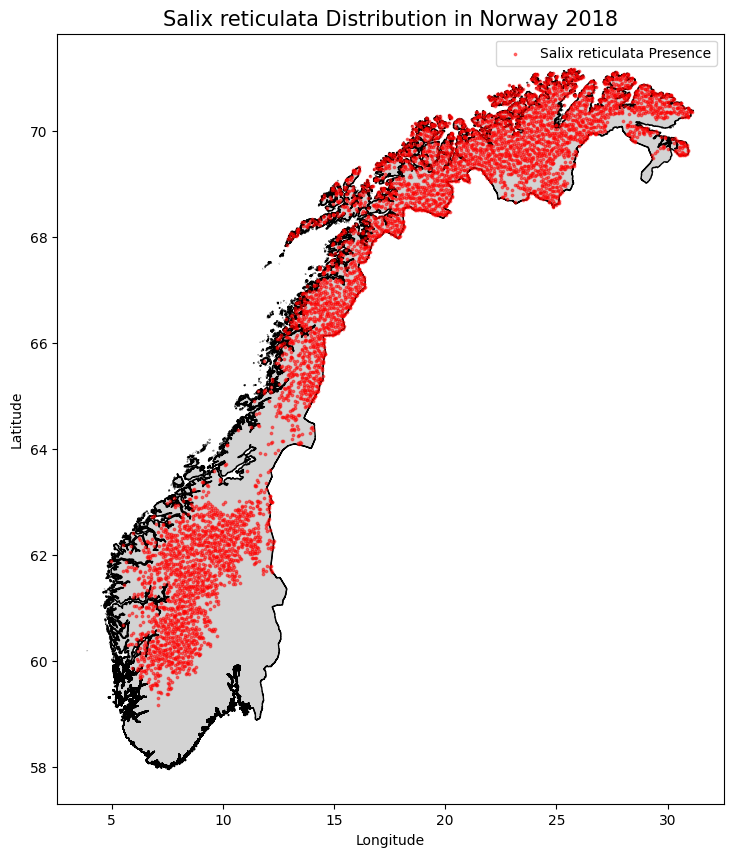

In [79]:
plotting_one_species_distribution_norway(df_2020_with_preds,'Salix reticulata')

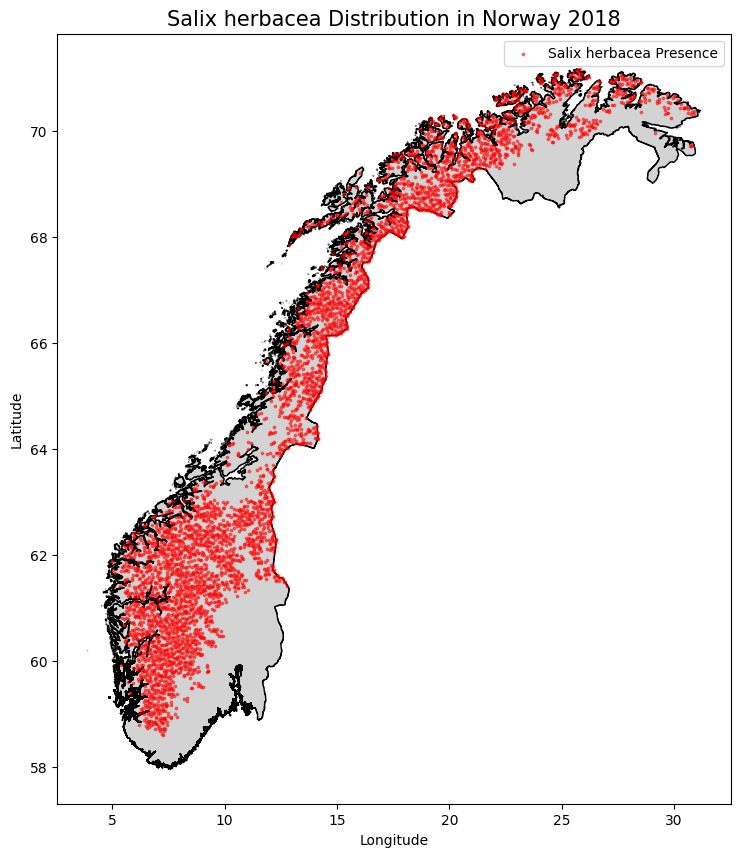

In [80]:
plotting_one_species_distribution_norway(df_2020_with_preds,'Salix herbacea')

### Plotting Multiple Species Distributions

In [83]:
def plotting_multiple_species_distribution_norway(df, species_list,tipo):    
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    
    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    colors = plt.get_cmap("tab10", len(species_list))  # Get distinct colors
    
    for i, sp_name in enumerate(species_list):
        index = species_universe[sp_name]
        mask = df['predicted_vector'].apply(lambda x: x[index] == 1)
        filtered_df = df[mask]

        result_geo_df = gpd.GeoDataFrame(
            filtered_df, 
            geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
            crs="EPSG:4326"
        )
        result_geo_df.plot(
            ax=ax,
            markersize=3,
            # color=colors(i),
            color='red',
            alpha=0.6,
            label=sp_name
        )

    ax.set_title(f"{tipo }Species Distributions in Norway", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    # ax.legend(markerscale=2)
    plt.show()


In [84]:
alpine_sp_list = ['Salix lanata', 'Salix polaris', 'Betula nana',
                  'Harrimanella hypnoides', 'Micranthes stellaris', 
                  'Oxyria digyna', 
                  'Sibbaldia procumbens', 'Ranunculus glacialis'] #  'Minuartia biflora','Juncus trifidus'

treeline_sp_list = ['Picea abies','Betula pubescens','Pinus sylvestris',
                    'Salix caprea','Alnus incana', 
                    'Lathyrus linifolius', 'Knautia arvensis', 'Prunus padus'] #'Linnea borealis',

len(alpine_sp_list),len(treeline_sp_list)

(8, 8)

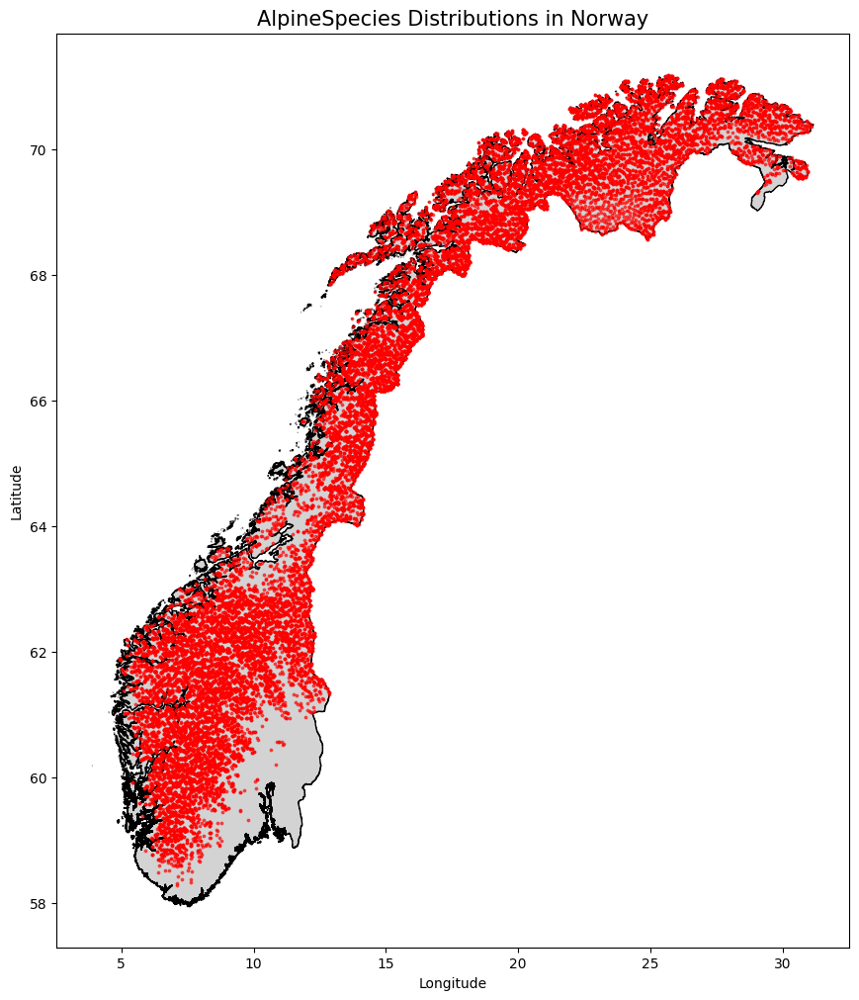

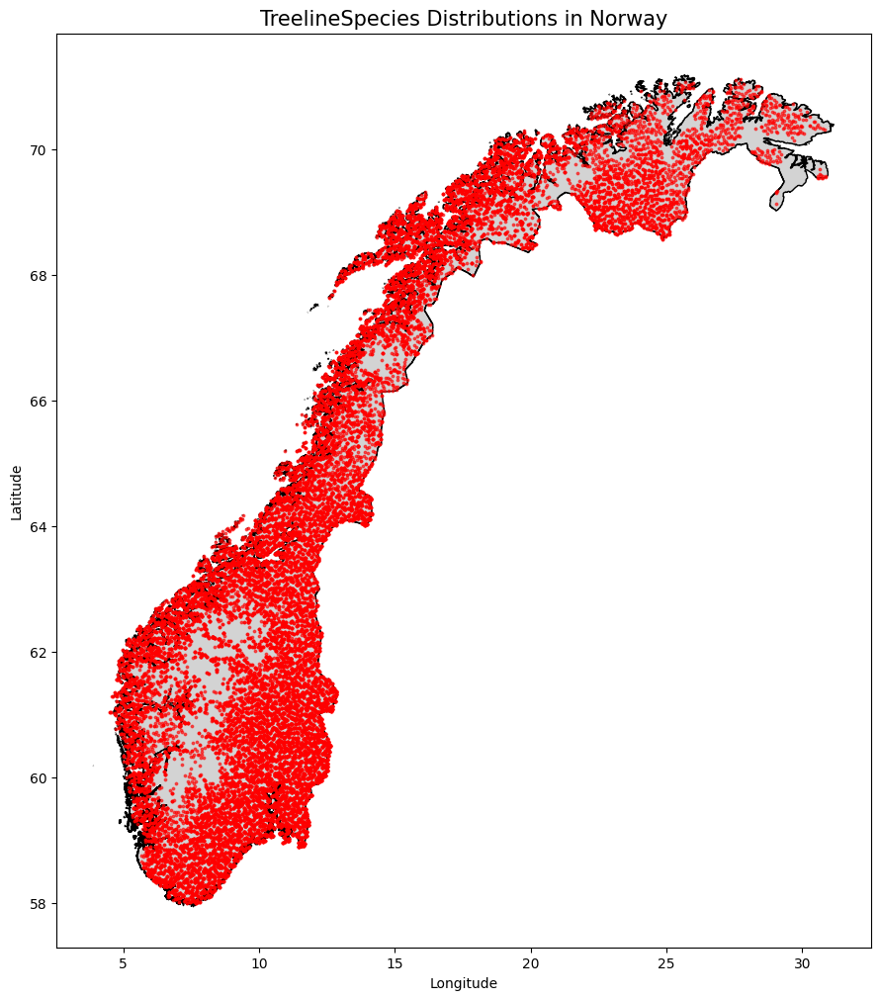

In [85]:

plotting_multiple_species_distribution_norway(df_2020_with_preds,alpine_sp_list,'Alpine')

plotting_multiple_species_distribution_norway(df_2020_with_preds,treeline_sp_list,'Treeline')

### Multiple Species Co-Ocurrence

In [86]:
def plotting_multiple_species_coocurrence_distribution_norway(df, species_list, tipo):    
    # Load Norway boundaries
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    
    # Get the list of species indices
    indices = [species_universe[sp_name] for sp_name in species_list]
    
    # Create a mask: rows where ALL species are present (i.e., value == 1 for all indices)
    mask = df['predicted_vector'].apply(lambda x: sum(x[i] == 1 for i in indices) >= 3)
    
    # Filter the DataFrame using the mask
    filtered_df = df[mask]
    
    # Create a GeoDataFrame from the filtered data
    result_geo_df = gpd.GeoDataFrame(
        filtered_df, 
        geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
        crs="EPSG:4326"
    )

    # Plotting
    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    result_geo_df.plot(
        ax=ax,
        markersize=3,
        color='red',
        alpha=0.6,
        label=f"All species: {', '.join(species_list)}"
    )

    ax.set_title(f"Simultaneous Distribution of Species in Norway ({tipo})", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    # ax.legend()
    plt.show()


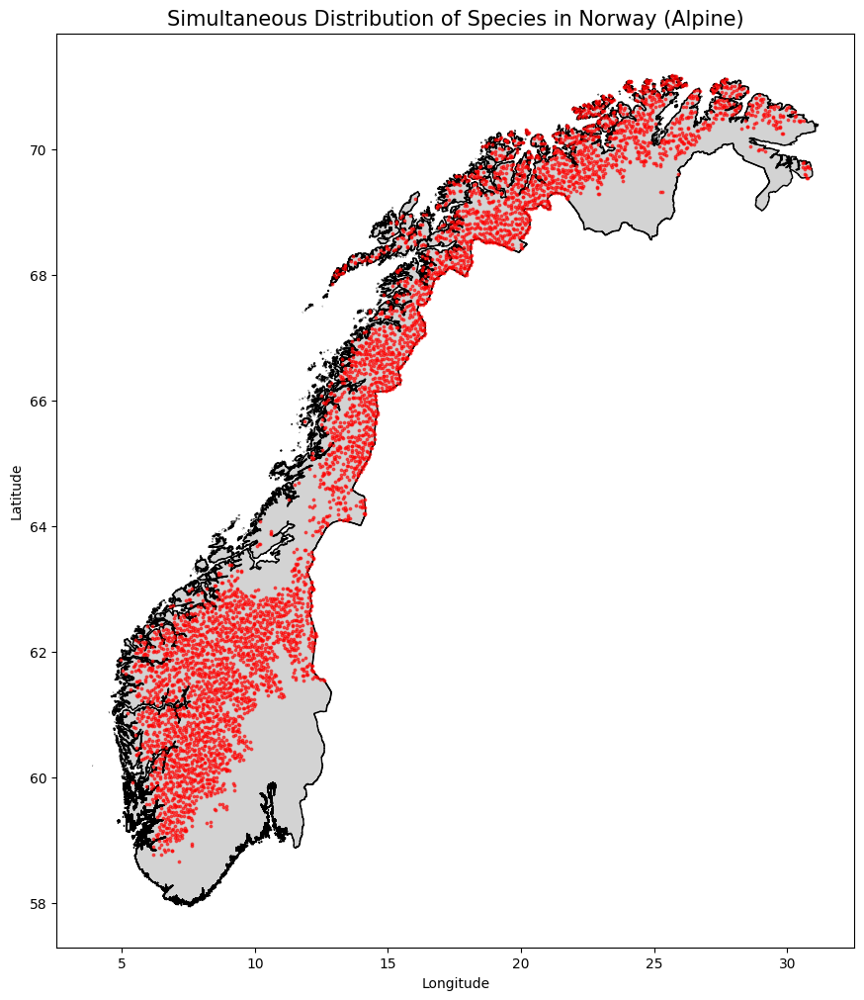

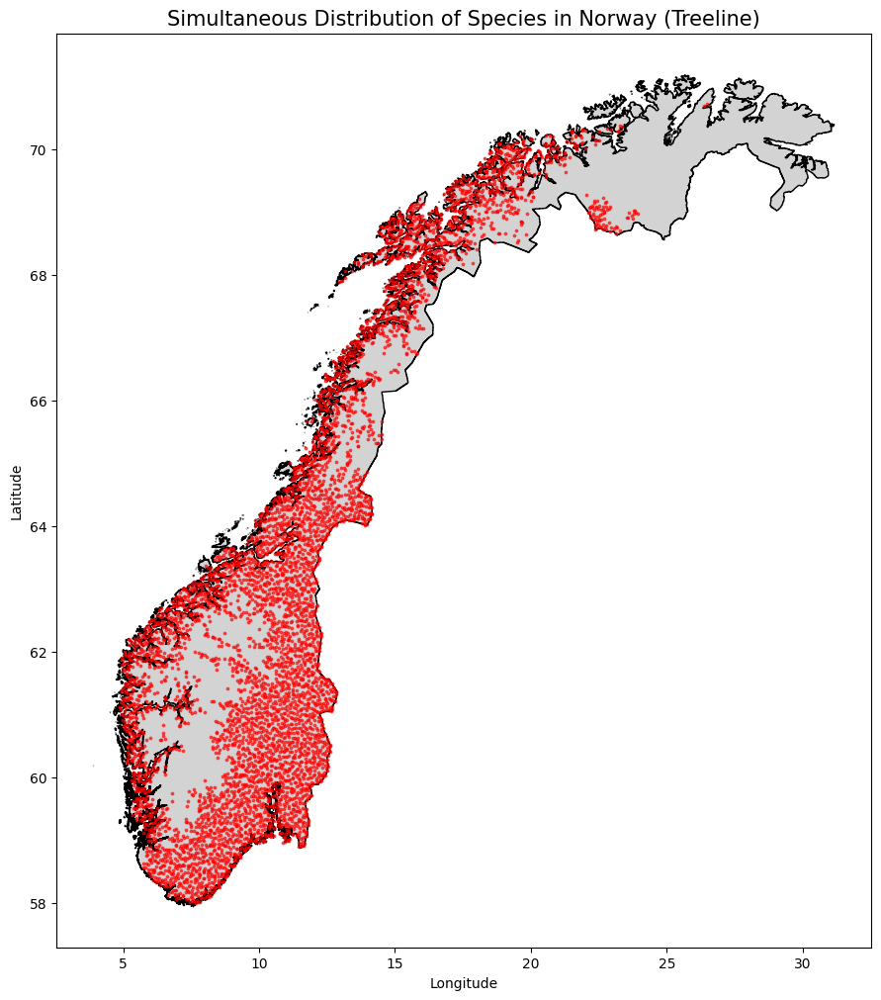

In [87]:

plotting_multiple_species_coocurrence_distribution_norway(df_2020_with_preds,alpine_sp_list,'Alpine')

plotting_multiple_species_coocurrence_distribution_norway(df_2020_with_preds,treeline_sp_list,'Treeline')

### Combined Plot

In [88]:
def plot_combined_species_groups(df, alpine_species, treeline_species, tipo="Combined"):

    # Load Norway shapefile
    norway = gpd.read_file("../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)

    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    # Process both groups
    for group_name, species_list, color in [
        ("Alpine", alpine_species, "blue"),
        ("Treeline", treeline_species, "green")
    ]:
        # Get indices
        indices = [species_universe[sp] for sp in species_list]

        # Keep only rows where ALL species in this group are present
        mask = df['predicted_vector'].apply(lambda x: sum(x[i] == 1 for i in indices) >= 3)
        filtered_df = df[mask]

        # Convert to GeoDataFrame
        geo_df = gpd.GeoDataFrame(
            filtered_df,
            geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
            crs="EPSG:4326"
        )

        # Plot
        geo_df.plot(ax=ax, markersize=4, color=color, alpha=0.6, label=f"{group_name} spp. ({len(geo_df)})")

    # Final plot settings
    ax.set_title(f"Alpine - Treeline 2018 Species Co-occurrence in Norway", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    # plt.savefig(f"../Images/{tipo} 2018 Species Co-occurrence in Norway.png")
    plt.show()


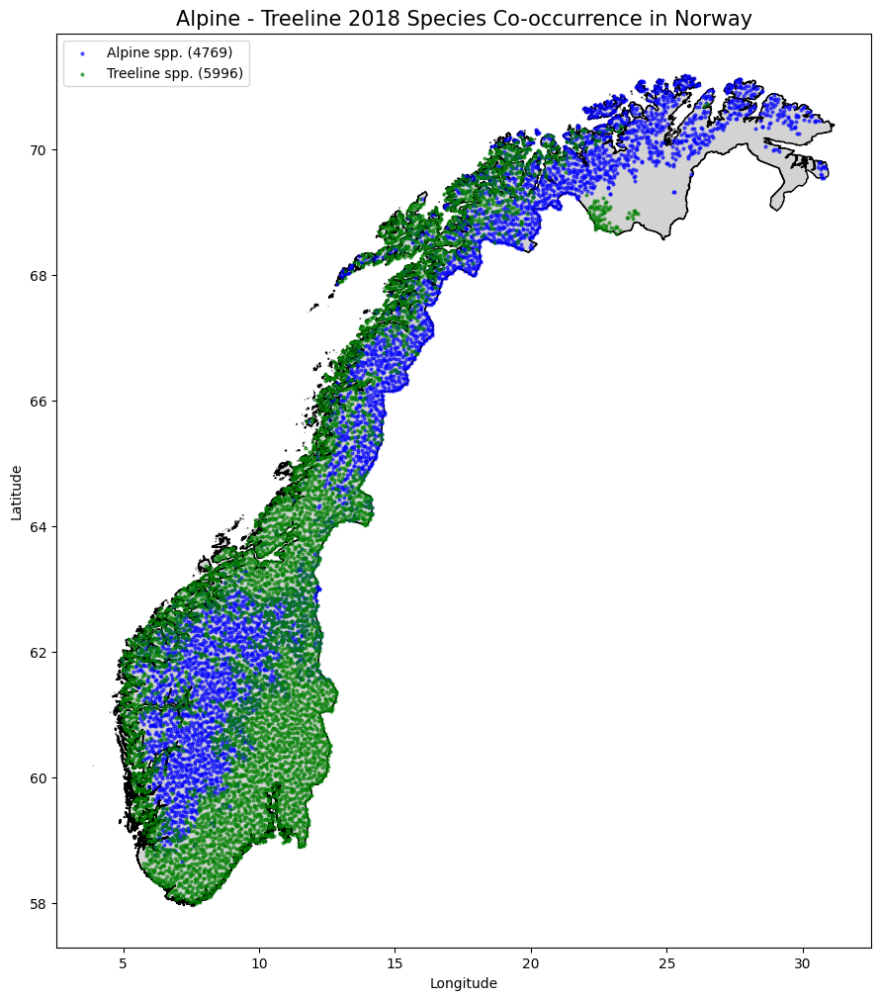

In [89]:
plot_combined_species_groups(df_2020_with_preds,alpine_sp_list,treeline_sp_list)

### Tests

In [76]:
# Create a boolean mask to filter rows where the species is present (predicted_vector[index] == 1)
specie_index = species_universe['Salix reticulata']
mask = df_2018_with_preds['predicted_vector'].apply(lambda x: x[specie_index] == 1)  # Check if species is present in predicted_vector

# Apply the mask to filter the DataFrame
filtered_df = df_2018_with_preds[mask]
filtered_df

,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
702,"POLYGON ((7.36511 59.20052, 7.36311 59.20943, ...",59.205487,7.372789,"[[[846.0515, 11.944797, 6.769123, 19.826292, 2...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",244
1036,"POLYGON ((6.80914 59.53648, 6.80697 59.54537, ...",59.541479,6.816806,"[[[1063.2517, 16.470514, 9.478959, 20.575836, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",205
1037,"POLYGON ((6.86381 59.53089, 6.86165 59.53978, ...",59.535884,6.871480,"[[[738.00146, 16.818768, 9.74937, 21.670605, 2...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",225
1042,"POLYGON ((7.27896 59.50208, 7.27691 59.51098, ...",59.507048,7.286689,"[[[715.8514, 13.463226, 8.127726, 23.035929, 1...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",237
1045,"POLYGON ((7.55127 59.55403, 7.5493 59.56293, 7...",59.558984,7.559057,"[[[1173.3517, 6.4480596, 3.8052602, 8.6776085,...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...",246
...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",297
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",313
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",301
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303


In [77]:
mask

0        False
1        False
2        False
3        False
4        False
         ...  
11465     True
11466     True
11467     True
11468     True
11469     True
Name: predicted_vector, Length: 11470, dtype: bool